# Final Project: WikiArt XAI
## CSC 594: Advanced Deep Learning
## Ross Pollock

In [ ]:
import tensorflow as tf
from tensorflow import  keras
from tensorflow.keras.backend import epsilon

import pickle as pk

import numpy as np

import matplotlib.pyplot as plt
from matplotlib import cm 

from glob import glob

from google.colab import drive
drive.mount('/drive')


Mounted at /drive


In [ ]:
! tar xfz /drive/My\ Drive/CSC594/Data/Image/wikiart.tar.gz -C /content/

Streaming output truncated to the last 5000 lines.
tar: Ignoring unknown extended header keyword 'SCHILY.nlink'
tar: Ignoring unknown extended header keyword 'SCHILY.dev'
tar: Ignoring unknown extended header keyword 'SCHILY.ino'
tar: Ignoring unknown extended header keyword 'SCHILY.nlink'
tar: Ignoring unknown extended header keyword 'SCHILY.dev'
tar: Ignoring unknown extended header keyword 'SCHILY.ino'
tar: Ignoring unknown extended header keyword 'SCHILY.nlink'
tar: Ignoring unknown extended header keyword 'SCHILY.dev'
tar: Ignoring unknown extended header keyword 'SCHILY.ino'
tar: Ignoring unknown extended header keyword 'SCHILY.nlink'
tar: Ignoring unknown extended header keyword 'SCHILY.dev'
tar: Ignoring unknown extended header keyword 'SCHILY.ino'
tar: Ignoring unknown extended header keyword 'SCHILY.nlink'
tar: Ignoring unknown extended header keyword 'SCHILY.dev'
tar: Ignoring unknown extended header keyword 'SCHILY.ino'
tar: Ignoring unknown extended header keyword 'SCHILY.

In [ ]:
#@tf.function
def img_preprocess(fpath):
    img = tf.io.read_file(fpath)
    img = tf.image.decode_jpeg(img,3)
    img = tf.cast(img,tf.float32)

    img = keras.preprocessing.image.smart_resize(img,(244,244))
    #img = tf.image.resize_with_crop_or_pad(img,244,244)

    img /= (255/2)
    img -= 1 
    return img 

def load_img(fpath):
  img = tf.io.read_file(fpath)
  img = tf.image.decode_jpeg(img,3)
  img = keras.preprocessing.image.smart_resize(img,(244,244))
  return img 

def GradCAM(
    model,cnn_name,
    image_path,label_encoder=None,
    target_idx=None,cmap='jet',
    **kwargs):
  
  # Load Original and Preprocessed Image
  original_image = load_img(image_path)
  preprocessed_image = img_preprocess(image_path)
  preprocessed_image = tf.expand_dims(preprocessed_image,0)

  feature_extractor = model.get_layer(cnn_name)
  classifier = model.get_layer(model.layers[-1].name)
  # 
  last_conv_name = feature_extractor.layers[-2].name
  last_conv_layer = feature_extractor.get_layer(last_conv_name)
  last_covn_model = keras.Model(feature_extractor.inputs,last_conv_layer.output)


  clf_input = keras.Input(shape=last_conv_layer.output.shape[1:])
  x = clf_input
  x = keras.layers.GlobalAveragePooling2D()(x)
  x = classifier(x)
  clf_model = keras.Model(clf_input,x)

  with tf.GradientTape() as tape:
    last_conv_model_out = last_covn_model(preprocessed_image)
    tape.watch(last_conv_model_out)
    preds = clf_model(last_conv_model_out)
    top_pred_idx = tf.argmax(preds[0])
    if target_idx: 
      top_class_channel = preds[:, target_idx]
    else: 
      top_class_channel = preds[:, top_pred_idx]
  if label_encoder:
    predicted_label = label_encoder.inverse_transform( np.expand_dims(top_pred_idx.numpy(),0) )[0]
  else:
    predicted_label = ''
  grads = tape.gradient(top_class_channel,last_conv_model_out)
  pooled_grads = tf.reduce_mean(grads,axis=[0,1,2])
  last_conv_model_out = last_conv_model_out.numpy()[0]
  pooled_grads = pooled_grads.numpy()

  for i in range(pooled_grads.shape[-1]):
    last_conv_model_out[:,:,i] *= pooled_grads[i]

  heatmap = np.mean(last_conv_model_out,axis=-1)
  heatmap = np.maximum(heatmap,0) / np.max(heatmap)
  resized_heatmap = tf.image.resize(
      images = tf.constant(heatmap[:,:,np.newaxis]),
      size = [original_image.shape[0], original_image.shape[1]]
  )

  heatmap = np.uint8(255*heatmap)
  jet = cm.get_cmap(cmap)
  jet_colors = jet(np.arange(256))[:,:3]
  jet_heatmap = jet_colors[heatmap]
  jet_heatmap = keras.preprocessing.image.array_to_img(jet_heatmap)
  jet_heatmap = jet_heatmap.resize((original_image.shape[1], original_image.shape[0]))
  jet_heatmap = keras.preprocessing.image.img_to_array(jet_heatmap)

  return jet_heatmap, resized_heatmap, predicted_label

def deprocess_image(x):
    """Same normalization as in:
    https://github.com/fchollet/keras/blob/master/examples/conv_filter_visualization.py
    """
    # normalize tensor: center on 0., ensure std is 0.25
    x = x.copy()
    x -= x.mean()
    x /= (x.std() + epsilon())
    x *= 0.25

    # clip to [0, 1]
    x += 0.5
    x = np.clip(x, 0, 1)

    # convert to RGB array
    x *= 255

    x = np.clip(x, 0, 255).astype('uint8')
    return x

@tf.custom_gradient
def guided_relu(x):
  def grad(dy):
    return tf.cast(dy>0,tf.float32) * tf.cast(x>0,tf.float32) * dy
  return tf.nn.relu(x), grad 

def guided_backprop(model,input_img,cnn_name='resnet50',target_idx=None):
  input_img = tf.expand_dims(input_img,0)
  cnn_model = model.get_layer(cnn_name)
  last_conv_layer_name = cnn_model.layers[-2].name 
  last_conv_layer = cnn_model.get_layer(last_conv_layer_name)
  guided_model = keras.Model(cnn_model.inputs,last_conv_layer.output)

  activation_layers = [layer for layer in guided_model.layers[1:] if hasattr(layer,'activation')] 

  classifier = model.get_layer(model.layers[-1].name)
  clf_input = keras.Input(shape=last_conv_layer.output.shape[1:])
  x = clf_input
  x = keras.layers.GlobalAveragePooling2D()(x)
  x = classifier(x)
  clf_model = keras.Model(clf_input,x)

  for layer in activation_layers:
    if layer.activation == tf.keras.activations.relu:
      layer.activation = guided_relu

  with tf.GradientTape() as tape:
    tape.watch(input_img)
    outputs = guided_model(input_img)
    predictions = clf_model(outputs)
    if target_idx:
      loss = predictions[:,target_idx]
    else:
       top_pred_idx = tf.argmax(predictions[0])
       loss = predictions[:,top_pred_idx]

  
  grads = tape.gradient(loss,input_img)[0]
  return grads, loss.numpy()[0] 

In [ ]:
# Download and extract model
model_url = 'https://rosspollock.design/models/resnet50120.tar.gz'
keras.utils.get_file('model2',model_url,untar=True,extract=True)
encoder = keras.models.load_model('/root/.keras/datasets/query_encoder120k')
cnn_name = encoder.layers[0].name
encoder = encoder.get_layer(cnn_name)
if encoder.name == 'ResNet50':
  new_encoder = ResNet(50,2,input_shape=(244,244,3))
  new_encoder.set_weights(encoder.get_weights())
  encoder = new_encoder 
  del new_encoder
_, rep_dim = encoder.output_shape

103489536/103482239 [==============================] - 5s 0us/step


In [ ]:
style_clf = keras.models.load_model('/drive/My Drive/CSC594/XAI/ArtStyleClfHead')
with open('/drive/My Drive/CSC594/XAI/art_style_labeler.pk','rb') as f:
  style_labeler = pk.load(f)

artist_clf =  keras.models.load_model('/drive/My Drive/CSC594/XAI/WikiArtistClfHead')
with open('/drive/My Drive/CSC594/XAI/artist_labeler.pk','rb') as f:
  artist_labeler = pk.load(f)


In [ ]:
style_model = keras.Sequential([encoder,style_clf])

In [ ]:
img_samples = glob('/content/wikiart_reduced/*/*.jpg')

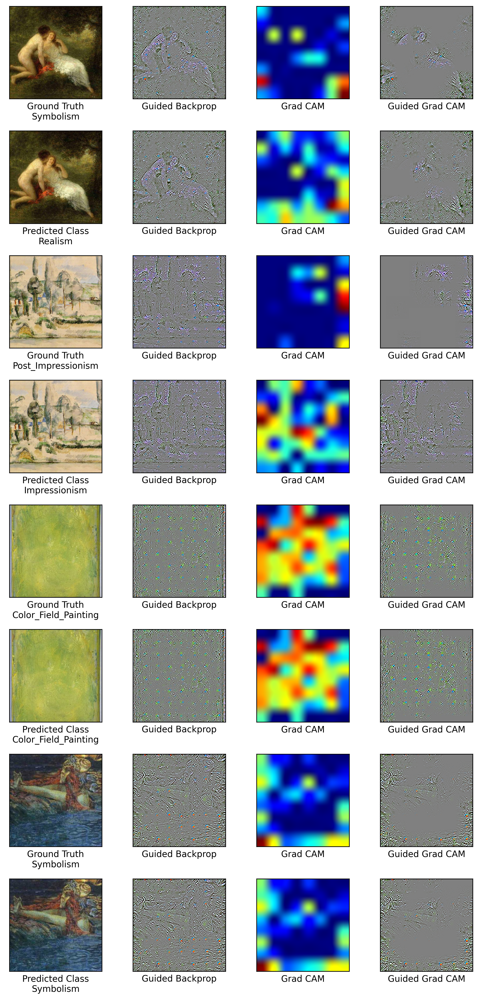

In [ ]:
test_imgs = np.random.choice(img_samples,size=4,replace=False)
doubled = []
for s in test_imgs:
  for _ in range(2):
    doubled.append(s)
nrows = len(test_imgs)
fig, axs = plt.subplots(ncols=4,nrows=nrows*2,figsize=(8,16),dpi=300)
for row,sample in enumerate(doubled):
  art_style = sample.split('/')[3]

  if row % 2 == 0:
    target_idx = style_labeler.transform([art_style])[0]
  else: 
    target_idx = None
  fpath = tf.constant(sample)
  original_img = tf.cast(load_img(fpath),tf.uint8)
  test_img = img_preprocess(fpath)
  grads, prob = guided_backprop(style_model,test_img,target_idx=target_idx)
  guided_backprop_img = np.flip(deprocess_image(grads.numpy()),-1)

  
  jet_heatmap,heatmap, predicted_label = GradCAM(
      style_model,'resnet50',fpath,
      label_encoder=style_labeler, target_idx = target_idx
  )
  guided_grads_cam = grads*heatmap

  order = {
      'Original':original_img,
      'Guided Backprop':guided_backprop_img,
      'Grad CAM':jet_heatmap.astype(np.uint8),
      'Guided Grad CAM': np.flip(deprocess_image(guided_grads_cam.numpy()),-1)

  }
  i = 0 
  for (k,v),ax in zip(order.items(),axs[row].ravel()):
    ax.imshow(v)
    ax.set_xticks([]); ax.set_yticks([])
    if i ==0: 
      if row % 2 == 0: 
        ax.set_xlabel(f'Ground Truth\n{art_style}')
      else: 
        ax.set_xlabel(f'Predicted Class\n{predicted_label}')
    else: ax.set_xlabel(k)
    i += 1
plt.tight_layout()
plt.savefig('/drive/My Drive/CSC594/XAI/imgs/style5.png')
plt.show()

In [ ]:
artist_model = keras.Sequential([encoder,artist_clf])

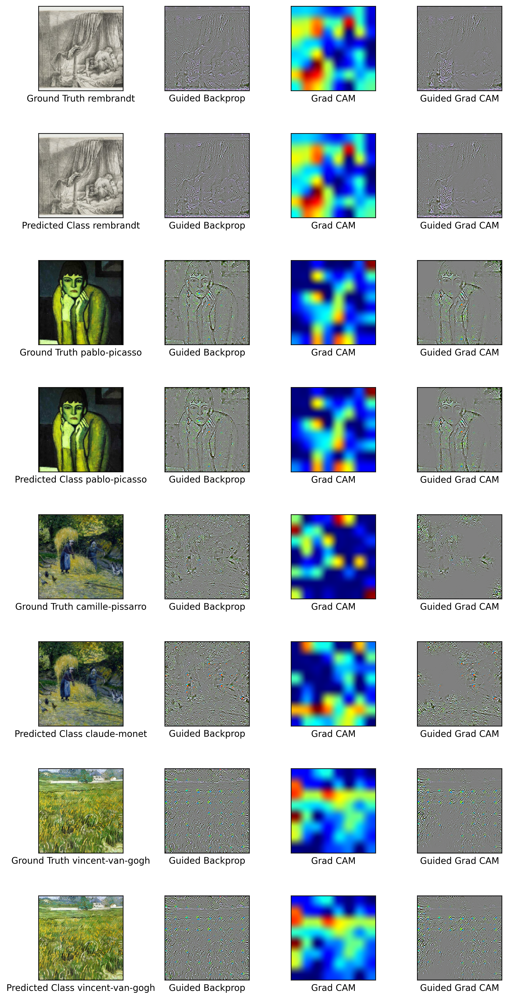

In [ ]:
test_imgs = np.random.choice(img_samples,size=100,replace=False)
nrows = 8
fig, axs = plt.subplots(ncols=4,nrows=nrows,figsize=(8,16),dpi=300)
row = 0 
for _,sample in enumerate(test_imgs):
  
  artist = sample.split('/')[4].split('_')[0]

  if artist in artist_labeler.classes_:
    if row >= nrows: break
    for idx in range(2):
      if idx == 0: target_idx = artist_labeler.transform([artist])[0]
      else: target_idx = None 
      fpath = tf.constant(sample)
      original_img = tf.cast(load_img(fpath),tf.uint8)
      test_img = img_preprocess(fpath)
      grads, prob = guided_backprop(artist_model,test_img,target_idx=target_idx)
      guided_backprop_img = np.flip(deprocess_image(grads.numpy()),-1)
      jet_heatmap,heatmap, predicted_label = GradCAM(
          artist_model,'resnet50',fpath,
          label_encoder=artist_labeler, target_idx = target_idx
      )
      guided_grads_cam = grads*heatmap

      order = {
          'Original':original_img,
          'Guided Backprop':guided_backprop_img,
          'Grad CAM':jet_heatmap.astype(np.uint8),
          'Guided Grad CAM': np.flip(deprocess_image(guided_grads_cam.numpy()),-1)

      }
      i = 0 
      for (k,v),ax in zip(order.items(),axs[row].ravel()):
        ax.imshow(v)
        ax.set_xticks([]); ax.set_yticks([])
        if i ==0: 
          if idx % 2 == 0: 
            ax.set_xlabel(f'Ground Truth\n{artist}')
          else: 
            ax.set_xlabel(f'Predicted Class\n{predicted_label}')
        else: ax.set_xlabel(k)
        i += 1
      row += 1 
      
  else: 
    continue
  
plt.tight_layout()
plt.show()